# Project ADA - Where to eat in Chicago?
## Group prADA

### Description

As part of this project, we intend to establish an interactive map allowing us to know where to eat in Chicago. The idea consists of orienting tourists as much as locals, in order to help them find the option that suits them best restaurant-wise. 

Initially, three main criterias were to be taken into account namely: 
- Sanitary information - Based on the results of the Chicago Food Inspections, we want to establish distinctions between food-establishments that conform to the required cleanliness norms and those that do not. 
- Safeness of the surroundings - Based on the crime records, the purpose is to try and sense whether the close neighborhood is quite safe or if it rather witnesses a high criminality rate and major misconducts. In this perspective, the goal is to help individuals and groups  who happen to be unfamiliar with the area, being aware of eventual security issues. 
- Reputation - A proposal was to conduct a sentiment analysis on online comments, reflecting the public's previous experiences with some specific food-establishments: positive or negative feedback on the food quality, menu variety, pricing and so on. However, due to technical and legal limitations linked to the non-availability of the relevant information, this selected criteria will be replaced by an analysis of the violations. Also resorting to NLP tools, it would be interesting to further understand the violations reported in the Chicago Food Inspections dataset, since they can refer to various distinct issues.


In [410]:
%matplotlib inline

# DATA ANALYSIS
import pandas as pd
import numpy as np
import pickle
import re
import math
import datetime

# DATA RECOVERY
import geopy
from geopy.geocoders import Nominatim 

# DATA VISUALIZATION
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins

The chicago_df pickle contains all the cleaning of the dataset done in milestone 2.

In [411]:
fi_df = pd.read_pickle('chicago_df.p')

fi_df['inspection date']=pd.to_datetime(fi_df['inspection date'])
fi_df['year'] =fi_df['inspection date'].apply(lambda d : d.year) #create a year column for further studies
fi_df['month'] = fi_df['inspection date'].apply(lambda d : d.month) #create a month column for further studies
fi_df['name'] = fi_df.apply(lambda row : row['restaurant name'] + ' ' + row['address'], axis = 1)

out_of_business = fi_df[fi_df['result'] == 'Out of Business']

In [412]:
out_of_business

,inspection id,license number,facility type,risk,address,city,state,zip,inspection date,inspection type,result,violations,latitude,longitude,location,restaurant name,numerical_risk,name,year,month
10201,2285259,2431840.0,restaurant,Risk 1 (High),335 S FRANKLIN ST,CHICAGO,IL,60606.0,2019-04-16,Canvass,Out of Business,20. PROPER COOLING TIME AND TEMPERATURE - Comm...,41.877259,-87.635041,"[41.87725919226483, -87.63504134173337]",SPOTTED MONKEY,2.0,SPOTTED MONKEY 335 S FRANKLIN ST,2019,4
18196,2232244,1242.0,restaurant,Risk 1 (High),323 E WACKER DR,CHICAGO,IL,60601.0,2018-10-25,Canvass,Out of Business,40. PERSONAL CLEANLINESS - Comments: FOOD HAND...,41.887556,-87.619655,"[41.887556040948596, -87.61965509328479]",PALM RESTAURANT,2.0,PALM RESTAURANT 323 E WACKER DR,2018,10
19096,2229340,2137370.0,restaurant,Risk 2 (Medium),1519 W MADISON,CHICAGO,IL,60607.0,2018-10-04,Canvass Re-Inspection,Out of Business,"55. PHYSICAL FACILITIES INSTALLED, MAINTAINED ...",41.881359,-87.665249,"[41.88135886163692, -87.66524938888526]",DUNKIN DONUTS,1.0,DUNKIN DONUTS 1519 W MADISON,2018,10
25810,2169696,2483425.0,restaurant,Risk 1 (High),1708 W LAWRENCE AVE,CHICAGO,IL,60640.0,2018-05-14,Canvass,Out of Business,3. POTENTIALLY HAZARDOUS FOOD MEETS TEMPERATUR...,41.968967,-87.671435,"[41.968966500431776, -87.67143451275741]",TAQUERIA PRIMO CHUKIS UPTOWN,2.0,TAQUERIA PRIMO CHUKIS UPTOWN 1708 W LAWRENCE AVE,2018,5
29627,2145808,1595203.0,restaurant,Risk 1 (High),111 S MORGAN ST,CHICAGO,IL,60607.0,2018-03-02,Canvass,Out of Business,"30. FOOD IN ORIGINAL CONTAINER, PROPERLY LABEL...",41.880048,-87.651832,"[41.880047970125254, -87.65183157127098]",MORGAN STREET CAFE,2.0,MORGAN STREET CAFE 111 S MORGAN ST,2018,3
53542,1981545,2374155.0,restaurant,Risk 1 (High),6406-6408 N OAKLEY AVE,CHICAGO,IL,60645.0,2017-01-17,Canvass Re-Inspection,Out of Business,18. NO EVIDENCE OF RODENT OR INSECT OUTER OPEN...,41.998031,-87.687603,"[41.99803106929147, -87.68760322515347]",MAWA PARADISE,2.0,MAWA PARADISE 6406-6408 N OAKLEY AVE,2017,1
54894,1955415,1767089.0,restaurant,Risk 1 (High),1102 W 35TH ST,CHICAGO,IL,60609.0,2016-12-15,Canvass,Out of Business,32. FOOD AND NON-FOOD CONTACT SURFACES PROPERL...,41.830760,-87.653584,"[41.83075999009257, -87.65358378376261]",PHIL'S PIZZA,2.0,PHIL'S PIZZA 1102 W 35TH ST,2016,12
60601,1960878,2437675.0,restaurant,Risk 1 (High),1914 W 79TH ST,CHICAGO,IL,60620.0,2016-09-20,Canvass Re-Inspection,Out of Business,"34. FLOORS: CONSTRUCTED PER CODE, CLEANED, GOO...",41.750363,-87.671359,"[41.750363436934514, -87.67135903192245]",KFC,2.0,KFC 1914 W 79TH ST,2016,9
73636,1632774,8932.0,restaurant,Risk 1 (High),2003-2009 N WESTERN AVE,CHICAGO,IL,60647.0,2016-03-08,Canvass,Out of Business,32. FOOD AND NON-FOOD CONTACT SURFACES PROPERL...,41.917676,-87.687266,"[41.91767649798009, -87.68726570179768]",LAZO'S TACOS,2.0,LAZO'S TACOS 2003-2009 N WESTERN AVE,2016,3
77298,1592097,1698569.0,grocery store,Risk 3 (Low),1425 E 71ST ST,CHICAGO,IL,60619.0,2015-12-24,Canvass,Out of Business,"34. FLOORS: CONSTRUCTED PER CODE, CLEANED, GOO...",41.765860,-87.590015,"[41.76585967052067, -87.59001488471206]",FAMILY DOLLAR STORE,0.5,FAMILY DOLLAR STORE 1425 E 71ST ST,2015,12


In [413]:
fi_df.head()

,inspection id,license number,facility type,risk,address,city,state,zip,inspection date,inspection type,result,violations,latitude,longitude,location,restaurant name,numerical_risk,name,year,month
1,2345986,2684121.0,mobile food preparer,Risk 2 (Medium),2300 S THROOP ST,CHICAGO,IL,60608.0,2019-11-20,License Re-Inspection,Fail,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...",41.850451,-87.658798,"[41.85045102427, -87.65879785567869]",TACOS & SALSAS,1.0,TACOS & SALSAS 2300 S THROOP ST,2019,11
3,2345959,1803815.0,restaurant,Risk 2 (Medium),4453 S ARCHER AVE,CHICAGO,IL,60632.0,2019-11-20,Canvass,Pass w/ Conditions,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...",41.812307,-87.706919,"[41.81230749019629, -87.7069186298686]",DUNKIN DONUTS,1.0,DUNKIN DONUTS 4453 S ARCHER AVE,2019,11
4,2345967,2699426.0,grocery store,Risk 2 (Medium),4307 W LAWRENCE AVE,CHICAGO,IL,60630.0,2019-11-20,License,Fail,"3. MANAGEMENT, FOOD EMPLOYEE AND CONDITIONAL E...",41.968045,-87.735750,"[41.96804517534159, -87.7357496871877]",SHEEBA MEAT & GROCERY,1.0,SHEEBA MEAT & GROCERY 4307 W LAWRENCE AVE,2019,11
5,2345980,2570118.0,restaurant,Risk 1 (High),7547 W IRVING PARK RD,CHICAGO,IL,60634.0,2019-11-20,Complaint,Fail,25. CONSUMER ADVISORY PROVIDED FOR RAW/UNDERCO...,41.952437,-87.816496,"[41.95243739681394, -87.81649552747085]",A & J KRAZY KITCHEN,2.0,A & J KRAZY KITCHEN 7547 W IRVING PARK RD,2019,11
7,2345921,1847417.0,restaurant,Risk 1 (High),3450 W FOSTER AVE,CHICAGO,IL,60625.0,2019-11-19,Canvass,Pass,49. NON-FOOD/FOOD CONTACT SURFACES CLEAN - Com...,41.975778,-87.715618,"[41.97577826268285, -87.715618214214]",Ban Po Chung,2.0,Ban Po Chung 3450 W FOSTER AVE,2019,11


# Quality analysis, of the restaurants based on their inspections.

The following part analyzes the evolution in time of the different restaurants, as well as the importance of the different violations. The aim is to come up with a quality score for each restaurant based on these two criterias.

## 1. Where do we eat according to the history of inspections results?

Here we want to analyze the history of the inspections results by restaurants. However we aren’t interested for now to the out of business inspection.
To memorize the history of a license inspection, we decided to turn the inspection result into a numerical value as we would give positive or negative points to a license depending on its result. 
However, the inspections aren’t equivalent, as they are referenced by type.


In [414]:
restaurant_oriented_group = fi_df.groupby('name')
inspections_oriented = fi_df[fi_df['result'] != 'Out of Business']
res_val = dict()
y = inspections_oriented.result.unique()
y

array(['Fail', 'Pass w/ Conditions', 'Pass', 'No Entry', 'Not Ready'],
      dtype=object)

In [415]:
res_val[y[0]] = -2
res_val[y[1]] = 1
res_val[y[2]] = 2
res_val[y[3]] = 0
res_val[y[4]] = 0

inspections_oriented['numerical_result'] = inspections_oriented['result'].apply(lambda x : res_val[x])

C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [416]:
y = inspections_oriented['inspection type'].apply(lambda x : x.lower()).unique()
y

array(['license re-inspection', 'canvass', 'license', 'complaint',
       'canvass re-inspection', 'short form complaint',
       'suspected food poisoning', 'complaint re-inspection',
       'recent inspection', 'suspected food poisoning re-inspection',
       'consultation', 'non-inspection', 'tag removal',
       'complaint-fire re-inspection', 'complaint-fire',
       'short form fire-complaint', 'license-task force',
       'license consultation', 'task force liquor 1475', 'fire complaint',
       'package liquor 1474', 'two people ate and got sick.',
       'canvass special events', 'no entry', 'pre-license consultation',
       'license task 1474', 'fire/complain', '1315 license reinspection',
       'task force liquor inspection 1474', 'task force liquor catering',
       'sfp', 'canvas', 'sfp/complaint', 'special events (festivals)',
       'smoking complaint', 'sfp recently inspected', 'tavern 1470',
       'canvass re inspection of close up',
       'license task force / not

We notice that inspections can reference ‘complaint’, ‘illegal’ and ‘poisoning’. So we want to penalize the licenses that are inspected for this kind of thing. Furthermore, re-inspections are done when the first one has failed, so the pass after a fail should give less points to the license than regular inspection passed at the first try.

In [417]:
def get_inspection_type_value(x):
    if re.search("complaint|poisoning|illegal", x):
        return -1
    if re.search("re-", x):
        return -0.5
    return 0
inspections_oriented['numerical_result'] = inspections_oriented.apply(lambda x : x['numerical_result'] + get_inspection_type_value(x['inspection type']), axis = 1)

C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [418]:
licenses_oriented_group = inspections_oriented.groupby('license number')
licenses_oriented = licenses_oriented_group['year'].agg(['min', 'max'])
licenses_oriented['activity'] = licenses_oriented.apply(lambda x : x['max'] - x['min'] + 1, axis = 1)
licenses_oriented = licenses_oriented.drop(columns = {'min', 'max'}).join(licenses_oriented_group['numerical_result'].agg('sum').to_frame())

In [419]:
licenses_oriented.corr()

,activity,numerical_result
activity,1.000000,0.811905
numerical_result,0.811905,1.000000


We can see the computed numerical result depends on the activity time of the license. It is logical has we expect a certain number of inspections per year depending on the risk of the restaurant. So as the numerical score we give is cumulative, the long the license is active, the more the numerical result tends to diverge either in negative range or positive range. So for a license we define its performance as the previous numerical result divided by its activity period.


In [420]:
licenses_oriented['performance'] = licenses_oriented.apply(lambda x : x['numerical_result']/x['activity'], axis = 1)

From this score we can now retrieve the score per restaurant. As the number of licenses varies from an establishment to another, we take the mean score over its licenses.

In [421]:
temp = inspections_oriented.merge(licenses_oriented.reset_index()[['license number','numerical_result']], left_on = 'license number', right_on = 'license number', suffixes=('_unit', '_total'))
temp = temp.drop_duplicates(subset = {'name', 'license number'})[['name','license number','numerical_result_total']]

In [422]:
restaurant_oriented = inspections_oriented.drop_duplicates(subset = {'name', 'latitude', 'longitude'})[['name', 'latitude','longitude', 'zip', 'facility type']]
restaurant_oriented.set_index('name', inplace = True)

In [423]:
restaurant_oriented = restaurant_oriented.join(temp.groupby('name').agg({'numerical_result_total':'mean'}))

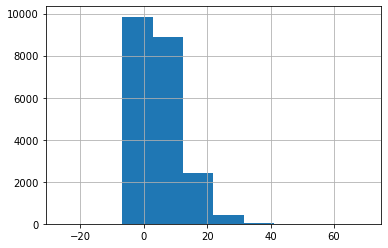

In [424]:
restaurant_oriented.rename(columns = {"numerical_result_total":"raw_performance"}, inplace = True)
restaurant_oriented['raw_performance'].hist()

In [425]:
dscr = restaurant_oriented['raw_performance'].describe()
dscr

count    21661.000000
mean         5.406319
std          6.171715
min        -26.000000
25%          2.000000
50%          3.000000
75%          8.000000
max         70.000000
Name: raw_performance, dtype: float64

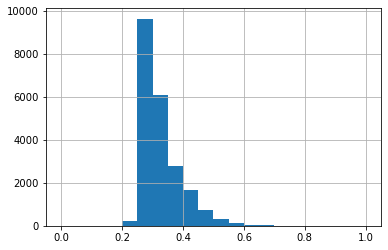

In [426]:
restaurant_oriented['mm_performance'] = (restaurant_oriented['raw_performance'] - dscr['min'])/(dscr['max'] - dscr['min'])
restaurant_oriented['mm_performance'].hist(bins = 20)

As the final score isn’t well distributed, we decided to attribute a class for 5 quantiles to uniformly distributing the establishments on a meaningful scale by giving “stars” to them.

In [427]:
quantiles = restaurant_oriented['raw_performance'].quantile([.2,.4,.6,.8])

In [428]:
def get_stars(x):
    if x <= quantiles[0.2]:
        return 1
    if x > quantiles[0.2] and x <= quantiles[0.4]:
        return 2
    if x > quantiles[0.4] and x <= quantiles[0.6]:
        return 3
    if x > quantiles[0.6] and x <= quantiles[0.8]:
        return 4
    if x > quantiles[0.8]:
        return 5
    
restaurant_oriented['stars'] = restaurant_oriented['raw_performance'].apply(lambda x : get_stars(x))

In [429]:
zip_areas = f'./Data/zip_boundaries.geojson'
zip_oriented = restaurant_oriented.groupby('zip').agg({'stars':'mean'})
starsByZip = zip_oriented.reset_index().astype({'zip':int}).astype({'zip':str})
m = folium.Map(location=[41.8781, -87.6298])

folium.Choropleth(
    geo_data=zip_areas,
    name='choropleth',
    data=starsByZip,
    columns=['zip', 'stars'],
    key_on='feature.properties.zip',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Stars per zip'
).add_to(m)

folium.LayerControl().add_to(m)

In [430]:
m.save('performance_stars.ht')

In [431]:
m

In [ ]:
m.save('maps/time_score_map.html')

You can find the map [here](maps/time_score_map.html).

## 2. Which areas can we recommend according to the history of violations?

However describing the score created above to define the sanitary quality of a restaurant doesn’t take into account the violations.
As a consequence we aim to regroup the violation types by categories and attribute the same amount of points to the violations of a same category according to its implication in failed inspections. So the score is scaled with the apparition frequency of the category in either failed inspections, passed with conditions inspections and passed inspections.


In [432]:
""" discard_comment and discard_violation are two helper methods
which help us treat the comment and violation part of the 'violations' column """

def discard_comment(x):
    if(x!='nan'):
        x=x.strip()
        x=x.split('- Comments:')
        x=x[0].strip().split('.')
        if(len(x)>1):
            return x[1].strip()
        else:
            return x[0]
        
    else:
        return 'No violation'

def discard_violation(x):
    if(x!='nan'):
        x=x.strip()
        x=x.split('- Comments:')
        if(len(x)>1):
            return x[1].strip()
        else:
            return 'No comments'
    else:
        return 'No violation'



In [433]:
#convert the column to the right data type and create a column comment (for later use if needed).

inspections_oriented['violations']=inspections_oriented['violations'].astype(str)
inspections_oriented['violations']=inspections_oriented['violations'].apply(lambda v:v.split('|'))
inspections_oriented['comments']=inspections_oriented['violations'].copy().apply(lambda v: [discard_violation(v_i) for v_i in v])


C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_i

In [434]:
#remove the comment part from the 'violations' column
inspections_oriented['violations']=inspections_oriented['violations'].apply(lambda v: [discard_comment(v_i) for v_i in v])

C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


The set of **rules**, groups all the different existing type of violation. It is a helper dataframe where we keep the information of the weight,category and category weight associated violation, we are going to compute the latter two in the following part. There are more than 100 rules (108 in fact), some of them are semantically very close so it is intersting to cluster them into groups and give a weight to each group in order to rank a restaurant based on its violations if existing. The categorisation was done with the help of the initial health inspection check list which can be found [here](https://www.chicago.gov/content/dam/city/depts/cdph/food_env/general/Food_Protection/FoodProtectionQuickGuide7272012b.pdf), we can categorize this given set of rules and weigh the categories.

In [435]:
rules=inspections_oriented['violations'].copy()
rules=np.unique(rules.explode())
rules=pd.Series(rules)
rules.head()

0    * CERTIFIED FOOD MANAGER ON SITE WHEN POTENTIA...
1    * INSPECTION REPORT SUMMARY DISPLAYED AND VISI...
2    ADEQUATE HANDWASHING SINKS PROPERLY SUPPLIED A...
3    ADEQUATE NUMBER, CONVENIENT, ACCESSIBLE, DESIG...
4    ADEQUATE NUMBER, CONVENIENT, ACCESSIBLE, PROPE...
dtype: object

In [436]:
categories={'Everything ok':[53],'Hand washing sinks for employees':[2,3,4,37,38,104],'Time and temperature':[9,14,19,32,64,65,72,73,74,75,79,80,82,92,93],
            'Contamination protection and vermin':[15,36,39,42,47,48,49,50,71,81,89],'Potable water':[40,87,105,107,108],
            'Waste':[35,55,66,77,86],'Certificates':[6,7,10,13,51,76,84,91,101],
            'General food safety requirements':[8,23,26,27,28,29,30,31,33,56,57,62,78,90,99,106],'Storage':[43,88,97,98,100],
            'Equipment/linens/ustensils':[11,16,17,18,22,24,34,41,45,52,85,109],'Physical facilities':[1,5,12,20,21,25,44,61,63,83,94,95,96,102,102,103],
           'Employees':[0,46,54,58,59,60,],'Improvements':[67,68,69,70]}

#first we mapp each violation to its assigned category
rules_df=pd.DataFrame(rules,columns=['violations'])
rules_categories=pd.Series([])

for c,indexes in categories.items():
    for ind in indexes:
        rules_categories[ind]=c   
rules_df['categories']=rules_categories

In [437]:
rules_df['categories'].value_counts()

General food safety requirements       16
Time and temperature                   15
Physical facilities                    15
Equipment/linens/ustensils             12
Contamination protection and vermin    11
Certificates                            9
Hand washing sinks for employees        6
Employees                               6
Potable water                           5
Waste                                   5
Storage                                 5
Improvements                            4
Everything ok                           1
Name: categories, dtype: int64

In [438]:
#now we want to quantify number of times a rule was violated w.r.t the result 'Pass', 'Fail', 'Not Ready', 'Pass w/ Conditions'
rr_df= inspections_oriented[['violations','result']]
rr_df=rr_df.explode('violations')
rr_df_count=rr_df.groupby('result')['violations'].value_counts()
rr_df_count.head() 

result  violations                                                                                                                            
Fail    FLOORS: CONSTRUCTED PER CODE, CLEANED, GOOD REPAIR, COVING INSTALLED, DUST-LESS CLEANING METHODS USED                                     16039
        WALLS, CEILINGS, ATTACHED EQUIPMENT CONSTRUCTED PER CODE: GOOD REPAIR, SURFACES CLEAN AND DUST-LESS CLEANING METHODS                      14897
        FOOD AND NON-FOOD CONTACT EQUIPMENT UTENSILS CLEAN, FREE OF ABRASIVE DETERGENTS                                                           14018
        NO EVIDENCE OF RODENT OR INSECT OUTER OPENINGS PROTECTED/RODENT PROOFED, A WRITTEN LOG SHALL BE MAINTAINED AVAILABLE TO THE INSPECTORS    13309
        FOOD AND NON-FOOD CONTACT SURFACES PROPERLY DESIGNED, CONSTRUCTED AND MAINTAINED                                                          12784
Name: violations, dtype: int64

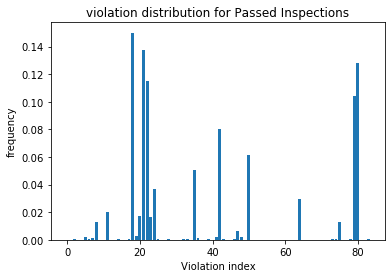

In [439]:
rr_df_pass=rr_df_count['Pass'].sort_index()
total=rr_df_pass.sum()

ratio_r1=rr_df_pass/total

plt.bar(x= range(len(rr_df_pass)), height= ratio_r1)
plt.title('violation distribution for Passed Inspections')
plt.xlabel('Violation index')
plt.ylabel('frequency')
plt.show()

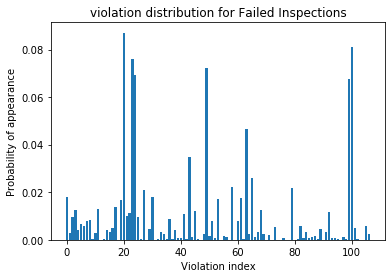

In [440]:
rr_df_fail=rr_df_count['Fail'].sort_index()
total=rr_df_fail.sum()
ratio_r1=rr_df_fail/total

plt.bar(x= range(len(rr_df_fail)), height= ratio_r1)
plt.title('violation distribution for Failed Inspections')
plt.xlabel('Violation index')
plt.ylabel('Probability of appearance')
plt.show()

From the plots we see that the violations that appear the most frequent appear in both passed and failed inspections. So in order to have a ranking that penalizes more the violations that only appeared in failed inspections we need to look at the non-overlapping violation sets. 

In [441]:
def intersection(lst1, lst2): 
    lst3 = [value for value in lst1.index if value in lst2.index] 
    return lst3 

inter_pass_fail=intersection(rr_df_count['Fail'],rr_df_count['Pass'])
inter_fail_n_ready=intersection(rr_df_count['Fail'],rr_df_count['Not Ready'])
inter_n_ready_pass_w=intersection(rr_df_count['Pass w/ Conditions'],rr_df_count['Not Ready'])
inter_pass_pass_w_cond=intersection(rr_df_count['Pass'],rr_df_count['Pass w/ Conditions']) # there is only one that is not contained in both i.e No violation

In [442]:

#failed alone
inters1= [value for value in rr_df_count['Fail'].index if value not in inter_pass_fail]
inters1=[value for value in inters1 if value not in inter_fail_n_ready]

#not ready alone
inters2=[value for  value in rr_df_count['Not Ready'].index]

#passed w/condition 
inters3=[value for value in rr_df_count['Pass w/ Conditions'].index if value not in inters1]
inters3=[value for value in inters3 if value not in inters2]


#passed alone ? == no violation
inters4=['No violation']

Now that we have our non-overlapping set of violations, we can give a weight to the number of times they appear. The weights are chosen in an arbitrary way, this could have been done in numerous other ways. The idea is here to have a low score for good restaurants and a bad score for the restaurant that violated the "worst" violations. We scale accordingly. The resulting distribution of weights is skewed, in order to have something closer to a ranking we normalize and apply the log function to linearize the weights. The final weights are distributed between  [1,2] This will be useful when combining with the time analysis score, more to come.

In [443]:
weight_fail=rr_df_count['Fail'].filter(inters1).apply(lambda c: 0.08*c)
weight_not_ready=rr_df_count['Not Ready'].filter(inters2).apply(lambda c: 0.06*c)
weight_pass=rr_df_count['Pass'].filter(inters4).apply(lambda c: 0)
weight_pass_w_condition=rr_df_count['Pass w/ Conditions'].filter(inters3).apply(lambda c:0.02*c)

weight_series=weight_not_ready.add(weight_fail.add(weight_pass.add(weight_pass_w_condition,fill_value=0),fill_value=0),fill_value=0)
weight_series = weight_series.sort_values(ascending=False)


In [444]:
final_ws = np.log(final_ws + 1)
min_,max_ = final_ws.describe()[['min', 'max']]
final_ws = 1 + (final_ws - min_) / (max_ - min_)


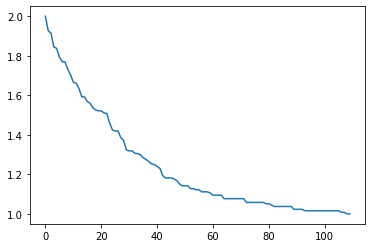

In [445]:
plt.plot(range(len(final_ws)), final_ws.values)

In [446]:
rules_df['weight']=rules_df['violations'].apply(lambda v: final_ws[v])

category_weight=rules_df.groupby('categories')['weight'].mean()
rules_df['category weight']=rules_df['categories'].copy().map(lambda v: category_weight[v])
final_rules=rules_df.set_index('violations')

inspections_oriented['violation_score']=inspections_oriented['violations'].apply(lambda vs:[final_rules.loc[v_i]['category weight'] for v_i in vs])
inspections_oriented['violation_score']=inspections_oriented['violation_score'].apply(lambda ws: sum(ws))


C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\k\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


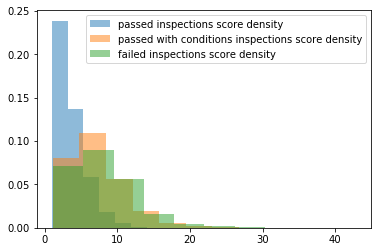

In [447]:
plt.hist(inspections_oriented[inspections_oriented['result']=='Pass']['violation_score'], density = True, alpha = 0.5, label = 'passed inspections score density')
plt.hist(inspections_oriented[inspections_oriented['result']=='Pass w/ Conditions']['violation_score'], density = True, alpha = 0.5, label = 'passed with conditions inspections score density')
plt.hist(inspections_oriented[inspections_oriented['result']=='Fail']['violation_score'], density = True, alpha = 0.5, label = 'failed inspections score density')
plt.legend(loc='upper right')
plt.show()

From it we can observe that despite the difference of penalties given according to the inspection result, we observe that the distribution among the subsets of inspections are different however the passed with conditions inspections and failed inspections seems to give the same kind of violations. The proximity between the distributions makes difficult to determine the result of an inspection based on the encountered violations.

In [448]:
import pickle

fi_df.to_pickle('./chicago_vscores.p')
rules_df.to_pickle('./violations_rules.p')

## Violation score vs performance

In [450]:
licenses_oriented = licenses_oriented.join(inspections_oriented.groupby('license number').agg({"violation_score":'mean'}))

In [451]:
temp = inspections_oriented.merge(licenses_oriented.reset_index()[['license number', 'violation_score']], left_on = 'license number', right_on = 'license number', suffixes =('_by_insp', '_by_lic'))
restaurant_oriented = restaurant_oriented.join(temp.drop_duplicates(subset ={'name', 'license number'}).groupby('name').agg({'violation_score_by_lic':'mean'}))

In [452]:
restaurant_oriented = restaurant_oriented.rename(columns = {'violation_score_by_lic':'violation_score'})

In [453]:
inspections_oriented.to_pickle('inspections_oriented.p')
licenses_oriented.to_pickle('licenses_oriented.p')
restaurant_oriented.to_pickle('restaurant_oriented.p')

In [454]:
restaurant_oriented[['raw_performance', 'violation_score']].corr()

,raw_performance,violation_score
raw_performance,1.000000,-0.017921
violation_score,-0.017921,1.000000


Here we confirm that the performance of a restaurant based on the inspections results and its violation score are uncorrelated.  

How are the score among the facility types

In [455]:
facility_type_oriented = restaurant_oriented.groupby('facility type').agg({'raw_performance':'mean', 'violation_score':'mean'})

In [456]:
facility_type_oriented.corr()

,raw_performance,violation_score
raw_performance,1.000000,0.387891
violation_score,0.387891,1.000000


In [457]:
zip_oriented = zip_oriented.join(restaurant_oriented.groupby('zip').agg({'violation_score':'mean'}))

In [458]:

scoreByZip = zip_oriented.reset_index().astype({'zip':int}).astype({'zip':str})
m = folium.Map(location=[41.8781, -87.6298])

folium.Choropleth(
    geo_data=zip_areas,
    name='choropleth',
    data=scoreByZip,
    columns=['zip', 'violation_score'],
    key_on='feature.properties.zip',
    fill_color='RdYlGn_r',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='violation score per zip'
).add_to(m)

folium.LayerControl().add_to(m)

In [459]:
m

In [ ]:
m.save('maps/violation_score_map.html')

You can find the map showing the mean violation score per zip area [here](maps/violation_score_map.html).

## Overall score for the inspections:

Combining the time analysis with the violation score. The idea is to have the violation score distributed between 1-2, why this? Because we would like the overall score to be a ratio between the history of inspection score we came up by analyzing the history of inspections and the violation score. A better the violation score (close to one) leaves the history score unchanged and in the worst case the history score would be divided by 2. 


In [460]:
min_, max_ = licenses_oriented.performance.describe()[['min', 'max']]
licenses_oriented['mm_performance'] = (licenses_oriented.performance - min_) / (max_ - min_)
licenses_oriented['norm_violation_score'] = np.log(licenses_oriented.violation_score)
min_,max_ = licenses_oriented['norm_violation_score'].describe()[['min','max']]
licenses_oriented['norm_violation_score'] = 1 + (licenses_oriented.norm_violation_score - min_ ) /(max_ - min_)
restaurant_oriented['norm_violation_score'] = np.log(restaurant_oriented.violation_score)
min_,max_ = restaurant_oriented['norm_violation_score'].describe()[['min','max']]
restaurant_oriented['norm_violation_score'] = 1 + (restaurant_oriented.norm_violation_score - min_ ) /(max_ - min_)
restaurant_oriented['overall_score'] = restaurant_oriented['mm_performance'] * 100 / restaurant_oriented['norm_violation_score']
licenses_oriented['overall_score'] = licenses_oriented['mm_performance'] * 100 / licenses_oriented['norm_violation_score']

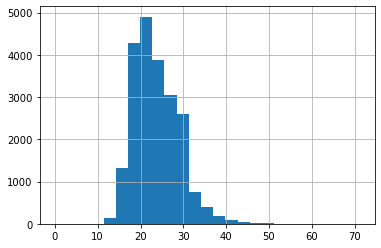

In [461]:
restaurant_oriented.overall_score.hist(bins = 25)

In [462]:
zip_oriented = zip_oriented.join(restaurant_oriented.groupby('zip').agg({'overall_score':'mean'}))

In [463]:
zip_oriented.head(10)

,stars,violation_score,overall_score
zip,,,
60501.0,1.000000,2.371930,22.134140
60601.0,3.494845,3.161559,27.239972
60602.0,3.469880,3.295880,26.995702
60603.0,3.443515,3.028065,27.254702
60604.0,3.511111,3.674665,26.754132
60605.0,3.331034,3.706604,25.602157
60606.0,3.426020,3.274357,26.986964
60607.0,3.063790,4.352587,23.882424
60608.0,2.596231,3.892236,23.388585


In [464]:
scoreByZip = zip_oriented.reset_index().astype({'zip':int}).astype({'zip':str})

In [465]:
m = folium.Map(location=[41.8781, -87.6298])

folium.Choropleth(
    geo_data=zip_areas,
    name='choropleth',
    data=scoreByZip,
    columns=['zip', 'overall_score'],
    key_on='feature.properties.zip',
    fill_color='RdYlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Overall Score'
).add_to(m)

folium.LayerControl().add_to(m)

m

In [466]:
closed_restaurants = out_of_business.drop_duplicates('name')[['name','latitude','longitude']].set_index('name')
for i in closed_restaurants.index:
    folium.Circle(
        radius=100,
        location=closed_restaurants.loc[i].values,
        popup=i,
        color='blue',
        fill=False).add_to(m)

In [ ]:
m.save('maps/inspection_score_map.html')

You can find the map of the inspection score per restaurants here [here](maps/closed_restaurants.html).

On the next map we show the localisation of the 'Out of business' restaurants. We would like to see if they appear in 'bad' areas or not. But from what we can see there seems to be no high correlation.

In [467]:
m

In [ ]:
m.save('maps/closed_restaurants.html')

You can find the map of closed restaurants here [here](maps/closed_restaurants.html). 

In [ ]:
stds = []
for zip_ in zip_oriented.index:
    stds.append(restaurant_oriented[restaurant_oriented.zip == zip_]['overall_score'].describe()['std'])


# Crime data exploitation : 

We take up from milestone 2 and go straight to the analysis

### The safety of the facility environment : eat safe with a perspective on the crime areas.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from helpers import *

In [2]:
crimes_df = pd.read_csv("crimes_cleaned.csv")
dates = pd.to_datetime(crimes_df['Date'])
crimes_df['Date'] = dates

def parse_coord(s):
    return [float(s[1:-1].split()[0][:-1]), float(s[1:-1].split()[1])]
crimes_df["Location"] = crimes_df["Location"].apply(parse_coord)
crimes_df

,ID,Date,Block,IUCR,Primary Type,Description,Location Description,Domestic,Community Area,Year,Latitude,Longitude,Location,Zip Code
0,11556037,2019-01-03 19:20:00,0000X W RWY 27R,2890,PUBLIC PEACE VIOLATION,OTHER VIOLATION,AIRCRAFT,False,76.0,2019,42.002816,-87.906094,"[42.002816387, -87.90609433]",60666.0
1,11626027,2019-03-16 17:58:00,001XX N WELLS ST,0460,BATTERY,SIMPLE,STREET,False,32.0,2019,41.883369,-87.633860,"[41.88336939, -87.633860272]",60602.0
2,11622422,2019-03-12 22:00:00,008XX E 38TH PL,0820,THEFT,$500 AND UNDER,RESIDENTIAL YARD (FRONT/BACK),False,36.0,2019,41.825347,-87.606781,"[41.825346902, -87.606780575]",60653.0
3,11625922,2019-03-14 18:42:00,074XX N PAULINA ST,0460,BATTERY,SIMPLE,RESIDENCE,False,1.0,2019,42.016542,-87.672499,"[42.016541612, -87.672499325]",60626.0
4,11622907,2019-03-14 16:03:00,008XX E 38TH PL,5002,OTHER OFFENSE,OTHER VEHICLE OFFENSE,STREET,True,36.0,2019,41.825299,-87.606961,"[41.825298645, -87.6069609]",60653.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6947085,9999998,2015-03-18 04:00:00,036XX W BELMONT AVE,0460,BATTERY,SIMPLE,RESIDENCE,False,21.0,2015,41.939208,-87.718022,"[41.939207846, -87.718021657]",60618.0
6947086,9999999,2015-03-18 17:08:00,043XX N CENTRAL AVE,0560,ASSAULT,SIMPLE,RESTAURANT,False,15.0,2015,41.959944,-87.767226,"[41.959943835, -87.767225719]",60634.0
6947087,11700926,2019-05-26 17:13:00,036XX W DOUGLAS BLVD,2825,OTHER OFFENSE,HARASSMENT BY TELEPHONE,APARTMENT,True,29.0,2019,41.862830,-87.717040,"[41.862830429, -87.717040084]",60623.0
6947088,24560,2019-05-26 06:48:00,013XX W HASTINGS ST,0110,HOMICIDE,FIRST DEGREE MURDER,CHA PARKING LOT,False,28.0,2019,41.864278,-87.659660,"[41.864278228, -87.659660218]",60608.0


No changes so far, we just reloaded the data set, cleaned it from what we don't need, changed the date to a "datetime" format and added a column Zip Code that represent the Zip area where the crime occured. This is usefull as we want to be consistent with what we did in the data set on the food inspection.

Here comes the interesting part, as we mentionned in milestone 2, we needed to modify the data set in order to have a good representation of the crimes that are interesting for us (in the context of "being safe while going out to eat"). For more information please refer to Milestone 2 as most of the work is already done there. But here are the main modifications we did : 
- We are not interested in the "Domestic crimes" as they refer to problem occuring in houses. Here we assume we want to go out to have a nice dinner or something to eat ! Hence every crime labeled "True" in "Domestic" column is droped
- It is also important to keep our informations up to date, so every crime older than 2010 will not be considered. This choice is even more motivated by the fact that our other data set (Food inspection) only begin in 2010. 
- As mentionned in the previous milestone, we want to have crime that occurs during breakfast/lunch or dinner time. So every crime from 00:00 to 6:00 AM are removed, because we assume nobody goes out to eat during those hours. 
- Some crimes categories don't affect a citizen going out to eat. Those were removed from the list as well. Here is the complete list of removed crimes :

**['NARCOTICS', 'WEAPONS VIOLATION', 'PROSTITUTION', 'INTERFERENCE WITH PUBLIC OFFICER', 'GAMBLING', 'LIQUOR LAW VIOLATION', 'ARSON', 'NON-CRIMINAL', 'OTHER NARCOTIC VIOLATION', 'RITUALISM', 'NON-CRIMINAL (SUBJECT SPECIFIED)', 'DOMESTIC VIOLENCE'].**


- We also then provide the list of crimes that we kept : 

**['BURGLARY', 'CRIM SEXUAL ASSAULT', 'THEFT', 'DECEPTIVE PRACTICE', 'OTHER OFFENSE', 'ASSAULT', 'ROBBERY', 'MOTOR VEHICLE THEFT', 'CRIMINAL TRESPASS', 'OFFENSE INVOLVING CHILDREN', 'SEX OFFENSE', 'BATTERY', 'CRIMINAL DAMAGE', 'INTIMIDATION', 'PUBLIC PEACE VIOLATION', 'CONCEALED CARRY LICENSE VIOLATION', 'STALKING', 'KIDNAPPING', 'HOMICIDE', 'PUBLIC INDECENCY', 'OBSCENITY', 'HUMAN TRAFFICKING', 'NON - CRIMINAL']**

- The exact same reasoning applies for crime location, here is the list of location we KEPT : 

**["OTHER","HOTEL/MOTEL", 'SIDEWALK',  "STREET", 'PARKING LOT/GARAGE(NON.RESID.)', 'STREET' , "RESTAURANT", 'BAR OR TAVERN', 'TAVERN/LIQUOR STORE', 'PARKING LOT', 'HOTEL', 'TAVERN','BANQUET HALL', 'ALLEY', 'WAREHOUSE', 'CONVENIENCE STORE', 'SMALL RETAIL STORE', 'GROCERY FOOD STORE']**. 

Every location is supposed to be food related. 

In [3]:
final_df = crimes_df[crimes_df['Domestic'] == False]
final_df = final_df[final_df['Year'] >= 2010]
final_df = final_df[final_df['Date'].apply(lambda x : x.hour) >= 6]
mask = ['NARCOTICS', 'WEAPONS VIOLATION', 'PROSTITUTION', 'INTERFERENCE WITH PUBLIC OFFICER', 'GAMBLING', 'LIQUOR LAW VIOLATION', 'ARSON', 'NON-CRIMINAL', 'OTHER NARCOTIC VIOLATION', 'RITUALISM', 'NON-CRIMINAL (SUBJECT SPECIFIED)', 'DOMESTIC VIOLENCE']
final_df = final_df[~final_df["Primary Type"].isin(mask)]
interesting_locations = ["OTHER","HOTEL/MOTEL", 'SIDEWALK',  "STREET", 'PARKING LOT/GARAGE(NON.RESID.)', 'STREET' , "RESTAURANT", 'BAR OR TAVERN', 'TAVERN/LIQUOR STORE', 'PARKING LOT', 'HOTEL', 'TAVERN','BANQUET HALL', 'ALLEY', 'WAREHOUSE', 'CONVENIENCE STORE', 'SMALL RETAIL STORE', 'GROCERY FOOD STORE']
final_df = final_df[final_df["Location Description"].isin(interesting_locations)]
final_df.shape

(904558, 14)

### Now we have a new list that correspond more to our research, let's have a quick look of how it compare to the full data set :
*Note : for all of the plots showed in this part, we used a helper function (in order to free some space and so that it could be more readable) given in the file "helpers.py".*

We start by a comparaison of crimes per year : 

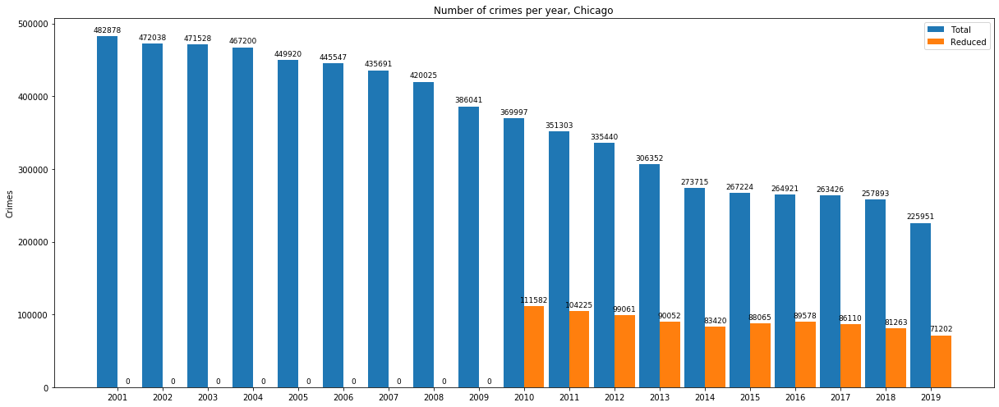

In [4]:
labels = np.arange(2001, 2020)
t = pd.DataFrame(crimes_df["Year"].value_counts())
t = t.rename(columns={"Year":"Total Crimes"})
t["Reduced Crimes"] = final_df["Year"].value_counts().astype(int)
t = t.fillna(0)
t["Reduced Crimes"] = t["Reduced Crimes"].astype(int)

barplot(np.arange(2001, 2020), t["Total Crimes"], t["Reduced Crimes"], 'Number of crimes per year, Chicago', 'Crimes')

The new data set is in orange. As we can see it does start only in 2010, and for each year, the selection of crimes we made correspond to about a third of all the crimes. The orange distribution follows more or less the blue distribution, so there are no big surprises about this. 

We are now interested by the crimes per hours to see if by selectiong certain places or type of crimes, this affect the distribution :

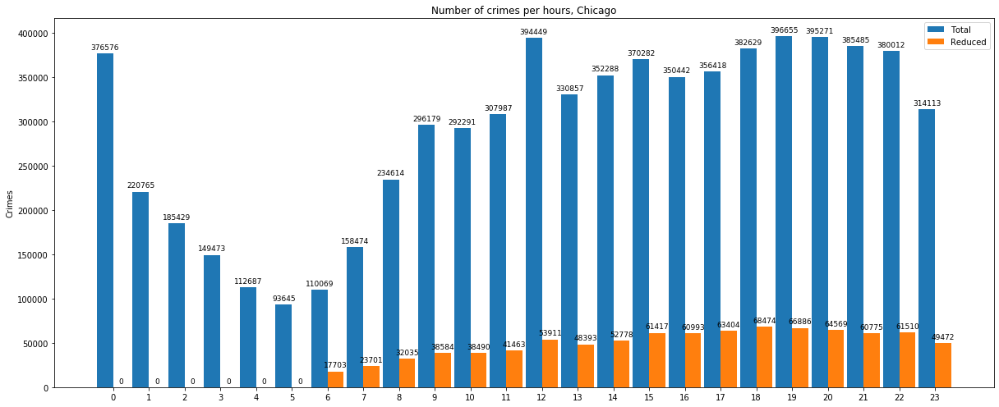

In [5]:
t = pd.DataFrame(crimes_df['Date'].apply(lambda x : x.hour).value_counts())
t = t.rename(columns={"Date":"Total Crimes"})
t["Reduced Crimes"] = final_df['Date'].apply(lambda x : x.hour).value_counts()
t = t.fillna(0)
t["Reduced Crimes"] = t["Reduced Crimes"].astype(int)
t= t.sort_index()

barplot(np.arange(0, 24), t["Total Crimes"], t["Reduced Crimes"], 'Number of crimes per hours, Chicago', 'Crimes') 

Now we check the repartiton per crime type :

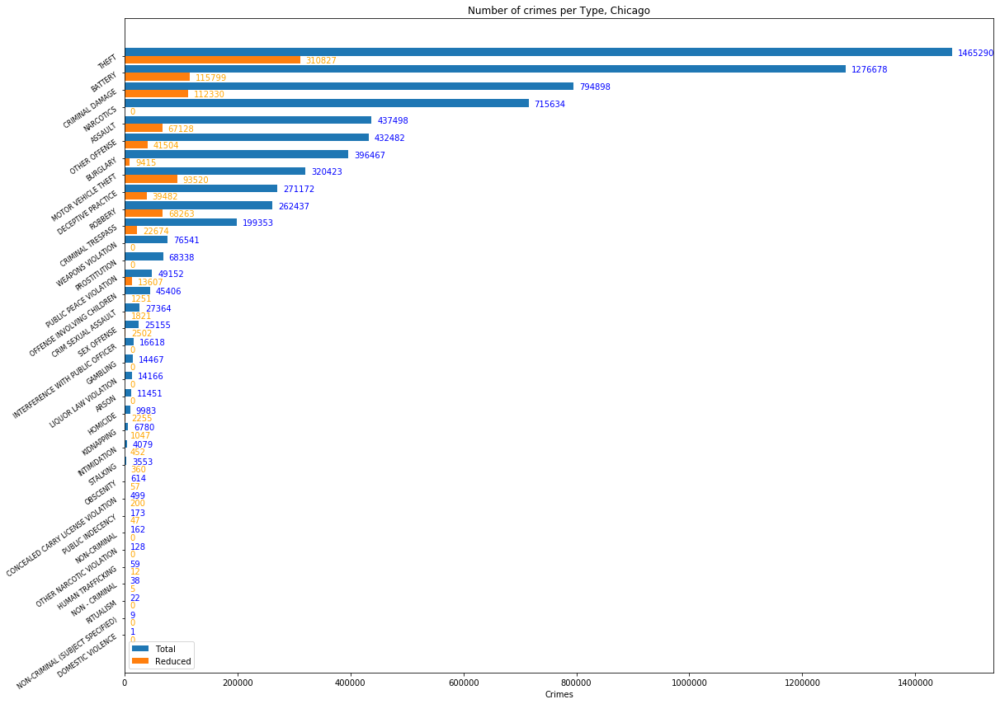

In [6]:
labels = crimes_df["Primary Type"].value_counts().index

t = pd.DataFrame(crimes_df['Primary Type'].value_counts())
t = t.rename(columns={"Primary Type":"Total Crimes"})
t["Reduced Crimes"] = final_df['Primary Type'].value_counts()
t = t.fillna(0)
t["Reduced Crimes"] = t["Reduced Crimes"].astype(int)

barploth(labels, t["Total Crimes"], t["Reduced Crimes"], 'Number of crimes per Type, Chicago', 'Crimes') 

As we can see, we kept the most "important" type, in the 10 most common crime type, only "Narcotics" was removed from our final set as it does not interest us. We can also notice that some crimes were reduced more than the others, as for instance "Buglary", this could be explained by a lot of factors (mostly done during the night, and in different places than the one we selected, etc...) but we do not focus on this problematic. 

Here we show the locations. As there is a lot of different possible location in the original data set, we only compare the ones that are in our final data set. 

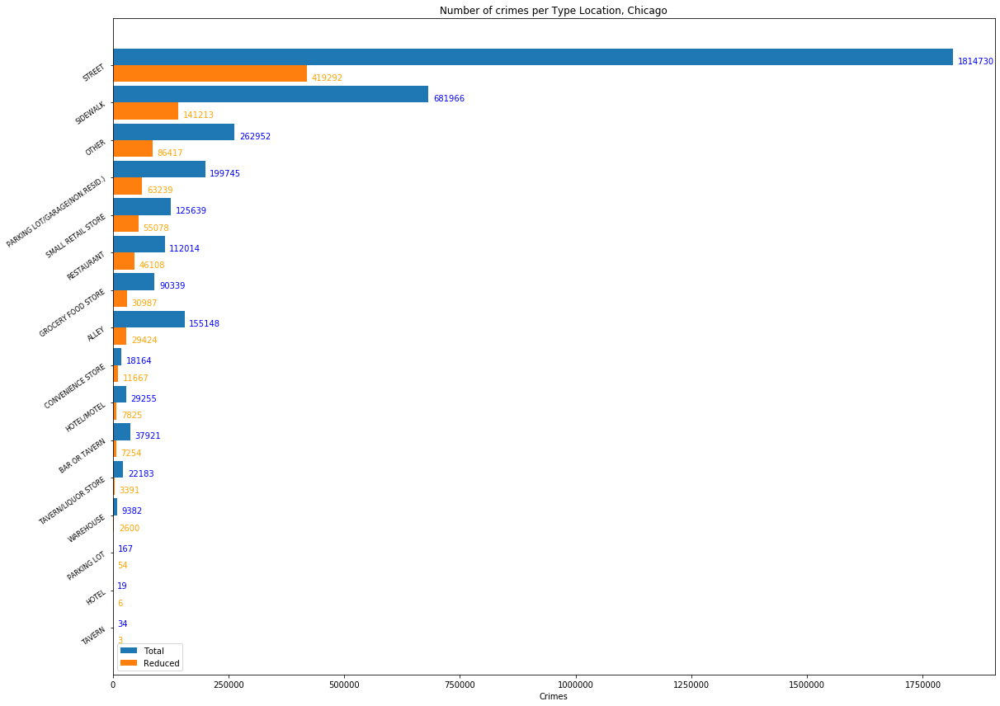

In [7]:
s = final_df["Location Description"].value_counts()
max_loc = min(len(s), 30)
labels = s.index[:max_loc]
    
t = pd.DataFrame(final_df['Location Description'].value_counts())
t = t.rename(columns={"Location Description":"Reduced Crimes"})
t["Total Crimes"] = crimes_df['Location Description'].value_counts()
t = t.fillna(0)
t["Reduced Crimes"] = t["Reduced Crimes"].astype(int)
t = t.head(max_loc)

barploth(labels, t["Total Crimes"], t["Reduced Crimes"], 'Number of crimes per Type Location, Chicago', 'Crimes')

Here again, no big surprises, the new data set distribution follows the old distribution quite well. 
As we are interested in the crimes per Zip Code, here is the plot showing the differences : 

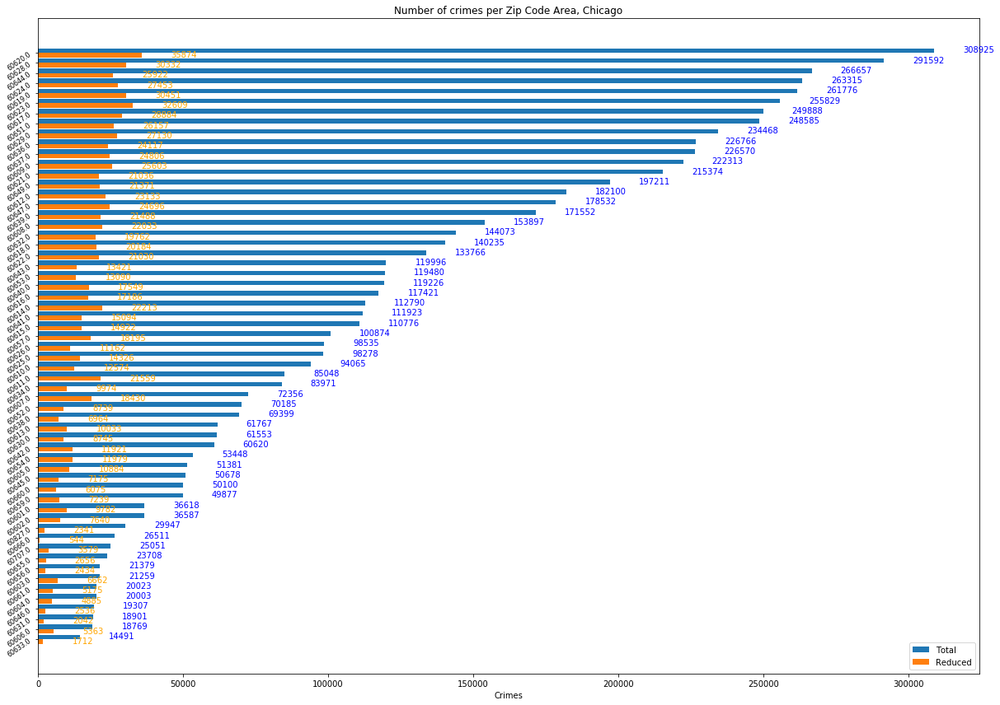

In [8]:
labels = crimes_df["Zip Code"].value_counts().index

t = pd.DataFrame(crimes_df["Zip Code"].value_counts())
t = t.rename(columns={"Zip Code":"Total Crimes"})
t["Reduced Crimes"] = final_df["Zip Code"].value_counts()
t = t.fillna(0)
t["Reduced Crimes"] = t["Reduced Crimes"].astype(int)

barploth(labels, t["Total Crimes"], t["Reduced Crimes"], 'Number of crimes per Zip Code Area, Chicago', 'Crimes')  

We now have a dataset that correspond to our need to answer our problem. The set contains 904558 crimes distributed all over the city. We now plot them on a map to see their repartition. 

## Crime Maps

The first map represent the number of crimes per Zip Code Area. This is with raw data (no modification or factors, just the total number of crimes).  

In [9]:
import folium
import json

chicago_coord = [41.8781136, -87.6297982]

m_area = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
state_geo_path = 'zip_boundaries.geojson'
geo_json_data = json.load(open(state_geo_path))
folium.GeoJson(geo_json_data).add_to(m_area)

In [10]:
data_map_final = pd.DataFrame(final_df["Zip Code"].value_counts())
data_map_final = data_map_final.reset_index()
data_map_final = data_map_final.rename(columns={"Zip Code": "nb crimes", "index":"Zip Code"})
data_map_final["Zip Code"] = data_map_final["Zip Code"].astype(int).astype(str)

In [11]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=data_map_final,
             columns=['Zip Code', 'nb crimes'],
             key_on='properties.zip',
             fill_color='OrRd', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Number of crimes per Zip Area')
m_test

C:\Users\Maxime C\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [12]:
m_test.save('crimes_per_zip.html')

You can find the map [here](maps/crimes_per_zip.html).

The map shows clear differences between areas, as we can see, the south and the west have way more "total crimes" than the rest of the city. Maybe this can be explained by another factor such as the density of population (more inhabitants means more crimes, so we take that factor into account). 

In [13]:
zip_df = pd.read_csv("zip_code_database.csv")
zip_df = zip_df[["zip", "irs_estimated_population_2015"]]
zip_df["zip"] = zip_df["zip"].astype(str)
data_map_final["Zip Code"] = data_map_final["Zip Code"].astype(str)
data_map_final = data_map_final.merge(zip_df, how = "left", left_on = "Zip Code", right_on = "zip")
data_map_final["average per inhabitant"] = data_map_final["nb crimes"]/data_map_final["irs_estimated_population_2015"]

In [14]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=data_map_final,
             columns=['Zip Code', 'average per inhabitant'],
             key_on='properties.zip',
             fill_color='OrRd', fill_opacity=0.7, line_opacity=0.5,
             legend_name='average Number of crimes per person per area')
m_test

In [15]:
m_test.save('avg_crimes_per_hab.html')

You can find the map [here](maps/avg_crimes_per_hab.html).

On this map we clearly see somes outliers : The city center is extremelly red (lots of crimes per inhabitants) but this can be easilly explained by the fact that there are very little inhabitant in this area but a lot of crimes (theft etc...). In order to have a better intuition of what is going on on the other part of the city, we remove these outliers.

In [16]:
data_map_final = data_map_final[data_map_final["average per inhabitant"] < 1]

In [17]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=data_map_final,
             columns=['Zip Code', 'average per inhabitant'],
             key_on='properties.zip',
             fill_color='OrRd', fill_opacity=0.7, line_opacity=0.5,
             legend_name='average Number of crimes per person per area')
m_test

In [18]:
m_test.save('crimes_inh_w_o_out.html')

You can find the map [here](maps/avg_crimes_per_hab.html).

Once the outliers are taken away, we have a clearer view of what is going on. As we can see the difference between the map of total crimes and the map of crimes per persons is minor. Most of the area that where "dangerous" on the first map are still higlhy red on the second map.

## Yelp data exploitation: What can we learn from the users perspective ? Do they reflect the inspectors reviews ?

## Quick overview 

*Note : all of the cleaning and preprocessing is done in milestone 2, please feel free to check it if needed, here we'll directly start from a clean data set*

In [19]:
def parse_price(s):
    i = 0
    for c in s:
        i += 1
    return i

reviews = pd.read_csv('result.csv')
reviews["coordinates"] = reviews["coordinates"].apply(parse_coord)
reviews["price"] = reviews["price"].apply(parse_price)
reviews = reviews[np.isfinite(reviews['Zip Code'])]
reviews["Zip Code"] = reviews["Zip Code"].astype(int).astype(str)
reviews.head()

,id,name,comment,language,rating,price,mean_rating,localizedDate,coordinates,Zip Code
0,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,The upstairs is my favorite place to study! Am...,en,5,1,4.5,Publié le 21/09/2019,"[41.808998, -87.703643]",60632
1,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,Such an amazing cute place to just come and re...,en,5,1,4.5,Publié le 15/11/2019,"[41.808998, -87.703643]",60632
2,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,"BEST place to study very quiet, great smoothie...",en,5,1,4.5,Publié le 21/09/2019,"[41.808998, -87.703643]",60632
3,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,This place is so cute and cozy. The first floo...,en,5,1,4.5,Publié le 30/11/2018,"[41.808998, -87.703643]",60632
4,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,I am definitely a fan! I had the oatmeal frapp...,en,5,1,4.5,Publié le 17/06/2019,"[41.808998, -87.703643]",60632


Here is our clean data set with all of the interesting features that are important for our project. Each row represent a comment from a user on Yelp. The reating is the rating left by the user and the "mean_rating" is the overall rating of the resaurant.

Let's have a quick overlook at the set in numbers

In [20]:
nb_comment = reviews.shape[0]
nb_rest = len(reviews['id'].unique())
dist_comments = reviews['id'].value_counts().mean()
mini = reviews['id'].value_counts().min()
maxi = reviews['id'].value_counts().max()

print("There is ", nb_comment, "comments in the dataset")
print("There is ", nb_rest, "different restaurant represented")
print("Each with an average of ", dist_comments, "comments")
print("With a minimum of ", mini, "and a maximum of", maxi)

There is  132231 comments in the dataset
There is  2082 different restaurant represented
Each with an average of  63.51152737752162 comments
With a minimum of  1 and a maximum of 160


In [21]:
unique = reviews.drop(columns = ["comment", "language", "rating", "localizedDate"])
unique = unique.drop_duplicates(subset = ["id"])
unique

,id,name,price,mean_rating,coordinates,Zip Code
0,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,1,4.5,"[41.808998, -87.703643]",60632
20,SfaA8AXQVtPY1JtAuJrgaw,La Catedral Cafe & Restaurant,2,4.5,"[41.846148, -87.709083]",60623
40,psz-vCo_OxNt21o6D0UfAw,Firecakes Donuts,1,4.0,"[41.89027, -87.63078]",60654
60,J8p4RhUFhlzJi8uwVX1qQg,Pastel! Cakes and More,2,4.0,"[41.80549, -87.72388]",60632
80,oZv8rpT80KZBudGeG_ICDw,Pete's Fresh Market,1,4.0,"[41.81382, -87.72279]",60632
...,...,...,...,...,...,...
148354,k2J6bT2n0qokBonClgCheQ,Starbucks,2,3.5,"[41.968947, -87.728943]",60630
148571,lyPwtVtlS38cDJLzsQGfNw,Colectivo,2,4.0,"[41.9805388, -87.668163]",60640
148591,u-hVFHuU33C0nxatcZOggQ,Hops & Grapes,2,4.5,"[42.0060658, -87.6612317]",60626
148631,IIAvO2kXUav4bJdYpxUhjA,ALDI,1,3.5,"[41.9950416, -87.6602424]",60660


In [22]:
from folium import plugins

chicago_coord = [41.8781136, -87.6297982]

m_area = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
state_geo_path = "Chicago_Community_Areas.json"
geo_json_data = json.load(open(state_geo_path))
folium.GeoJson(geo_json_data).add_to(m_area)

In [23]:
m_area.add_child(plugins.HeatMap(unique["coordinates"].values,
                            radius=5,
                            max_zoom=1,
                            blur=10, 
                            max_val=3.0))
m_area

In [24]:
m_area.save('reviews_heatmap.html')

You can find the map [here](maps/reviews_heatmap.html).

We notice that we are missing data in some of the areas, and so we won't be able to produce a score for these area. 

Let's focus on the ratings now :

In [25]:
unique["mean_rating"].value_counts()

4.0    562
4.5    480
3.5    347
3.0    203
5.0    160
2.5    135
2.0     98
1.5     61
1.0     36
Name: mean_rating, dtype: int64

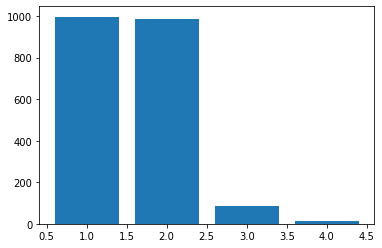

In [26]:
plt.bar(np.arange(1,5), unique["price"].value_counts())
plt.show()

In [27]:
mean_rating_df = unique[["mean_rating", "price", "Zip Code"]].groupby("Zip Code").mean()
mean_rating_df["Count"] = unique["Zip Code"].value_counts()
mean_rating_df

,mean_rating,price,Count
Zip Code,,,
60601,3.705882,1.617647,34
60602,3.684211,1.789474,19
60603,3.528571,1.714286,35
60604,3.833333,1.777778,18
60605,3.476744,1.627907,43
60606,3.827586,1.448276,29
60607,3.756410,1.602564,78
60608,3.679012,1.407407,81
60609,3.107143,1.428571,42


We now have the mean price and rating per area, we make sure to get rid of areas that have not enough data to correctly represent them. 

In [28]:
drop = mean_rating_df[mean_rating_df["Count"] < 5].index
mean_rating_df.drop(drop, inplace = True)

 let's plot 2 different maps showing the mean prices and ratings :

In [29]:
state_geo_path = "zip_boundaries.geojson"
geo_json_data = json.load(open(state_geo_path))

m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=mean_rating_df.reset_index(),
             columns=['Zip Code', 'mean_rating'],
             key_on='properties.zip',
             fill_color='YlGn', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Rating per Zip Area')
m_test

In [30]:
m_test.save('rate_per_zip.html')

You can find the map [here](maps/rate_per_zip.html).

In [31]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=mean_rating_df.reset_index(),
             columns=['Zip Code', 'price'],
             key_on='properties.zip',
             fill_color='YlGn', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Price per Zip Area')
m_test

In [32]:
m_test.save('price_per_zip.html')

You can find the map [here](maps/price_per_zip.html).

## Sentiment analysis

Another interesting aspect of this data set is the sentiment analysis of the comments left by the users. With the analysis of the comments, we make another score for the area and restaurant that will complete the mean ratings. 

In [33]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import nltk
from nltk.corpus import stopwords

comments = reviews["comment"].values

To do the sentiment analysis, we use Vader : https://github.com/cjhutto/vaderSentiment 

*"VADER Sentiment Analysis. VADER (Valence Aware Dictionary and sEntiment Reasoner) is a lexicon and rule-based sentiment analysis tool that is specifically attuned to sentiments expressed in social media, and works well on texts from other domains."*

In [34]:
analyzer = SentimentIntensityAnalyzer()
sentiments = []

for sentence in comments:
    vs = analyzer.polarity_scores(sentence)
    s = vs["compound"]
    if s > 0:
        sentiments.append(1)
    else :
        sentiments.append(-1)

In [35]:
reviews["sentiments"] = sentiments

"1" means positive and "-1" negative

In [36]:
reviews["sentiments"].value_counts()

 1    116258
-1     15973
Name: sentiments, dtype: int64

As we can see there are way more positive comments than negative ones. Let's try to see if this is coherent using the ratings given with the comments. 

In [37]:
negatives = reviews[reviews["sentiments"] == -1]
positives = reviews[reviews["sentiments"] == 1]

negatives["rating"].mean()

1.9622487948412948

In [38]:
positives["rating"].mean()

4.19210720982642

As we can see it look like the sentiment analysis works well, the mean of the comments rating for negatives sentiments is below 2/5 while the mean for the positive is above 4/5.

Using the new sentiment analysis, we try to see if it correlates with the previously printed map of the mean rating per area. We first plot maps that represent the average positives and negatives comments per restaurant per area. 

In [39]:
negatives = negatives[["Zip Code", "sentiments"]]
negatives = negatives.groupby("Zip Code").sum()
negatives = negatives.reset_index()

In [40]:
positives = positives[["Zip Code", "sentiments"]]
positives = positives.groupby("Zip Code").sum()
positives = positives.reset_index()

In [41]:
mean_rating_df = mean_rating_df.merge(negatives, on = "Zip Code")
mean_rating_df = mean_rating_df.merge(positives, on = "Zip Code", suffixes=('_neg', '_pos'))

In [42]:
mean_rating_df["sentiments_neg"] = abs(mean_rating_df["sentiments_neg"])
mean_rating_df["Average neg"] = mean_rating_df["sentiments_neg"]/mean_rating_df["Count"]
mean_rating_df["Average pos"] = mean_rating_df["sentiments_pos"]/mean_rating_df["Count"]

In [43]:
state_geo_path = "zip_boundaries.geojson"
geo_json_data = json.load(open(state_geo_path))

m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=mean_rating_df,
                 columns=['Zip Code', 'Average neg'],
             key_on='properties.zip',
             fill_color='OrRd', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Average negatives comments per Restaurant')
m_test

C:\Users\Maxime C\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [44]:
m_test.save('avg_neg_comm.html')

You can find the map [here](maps/avg_neg_comm.html).

In [45]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=mean_rating_df,
                 columns=['Zip Code', 'Average pos'],
             key_on='properties.zip',
             fill_color='YlGn', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Average positve comments per Restaurant')
m_test

In [46]:
m_test.save('maps/sentiment_score_pos.html')

You can find the map [here](maps/sentiment_score_pos.html).

Clearly these maps are not really usefull as the same area are highlighted. This can be explained by the fact that thoses area have way more comments than other area, so they have more positive but also negatives comments. Since we can't get any usefull information out of this, we try another metric.

We compute the percentage of negative comments per area :

In [48]:
mean_rating_df["Percentage pos"] = mean_rating_df["sentiments_pos"]/(mean_rating_df["sentiments_neg"] + mean_rating_df["sentiments_pos"]) * 100
mean_rating_df

,Zip Code,mean_rating,price,Count,sentiments_neg,sentiments_pos,Average neg,Average pos,Percentage pos
0,60601,3.705882,1.617647,34,389,2838,11.441176,83.470588,87.945460
1,60602,3.684211,1.789474,19,216,1708,11.368421,89.894737,88.773389
2,60603,3.528571,1.714286,35,398,2478,11.371429,70.800000,86.161335
3,60604,3.833333,1.777778,18,183,1508,10.166667,83.777778,89.178001
4,60605,3.476744,1.627907,43,456,2643,10.604651,61.465116,85.285576
5,60606,3.827586,1.448276,29,220,1459,7.586207,50.310345,86.896962
6,60607,3.756410,1.602564,78,701,5471,8.987179,70.141026,88.642255
7,60608,3.679012,1.407407,81,521,3826,6.432099,47.234568,88.014723
8,60609,3.107143,1.428571,42,210,808,5.000000,19.238095,79.371316
9,60610,3.980000,1.840000,25,246,2210,9.840000,88.400000,89.983713


There is one major outlier (area 31) that is almost 2 times higher than the second highest on the list, we only have 7 representative restaurant of this area with about 50 comments for thoses restaurants. After checking on the food-inspection data set, we can see that there is more than 250 restaurants in that area, So we decide to discard this outlier, but we keep in mind that this is probably an area with a bad score.

In [49]:
drop = mean_rating_df[mean_rating_df["Percentage pos"] < 40].index
mean_rating_df.drop(drop, inplace = True)

In [50]:
m_test = folium.Map(location=chicago_coord, tiles='cartodbpositron', zoom_start = 10)
m_test.choropleth(geo_data=geo_json_data, data=mean_rating_df,
                 columns=['Zip Code', 'Percentage pos'],
             key_on='properties.zip',
             fill_color='OrRd', fill_opacity=0.7, line_opacity=0.5,
             legend_name='Percentage of negatif comments')
m_test

In [51]:
m_test.save('maps/sentiment_score_pos.html')

You can find the map [here](maps/sentiment_score_neg.html).


We now have a better representation of the sentiment analysis. We have a clear distinction of area among the city. 

In [52]:
t = reviews[["sentiments", "id"]].groupby("id")["sentiments"].value_counts()
t1 = pd.DataFrame(t)
t1['percent'] = t1.groupby(level=0).transform(lambda x: (x / x.sum()).round(2))
t1 = t1.rename(columns = {"sentiments" : "test"})
t1 = t1.reset_index()
t1 = t1[t1["sentiments"] == 1].drop(columns = ["sentiments", "test"])

In [53]:
rest_score = reviews.drop_duplicates(subset = ["id"])
rest_score = rest_score.drop(columns = ["comment", "language", "rating", "localizedDate", "sentiments"])
rest_score = rest_score.merge(t1, on = "id")
rest_score = rest_score.merge(data_map_final[["Zip Code", "nb crimes"]], on = "Zip Code")
rest_score

,id,name,price,mean_rating,coordinates,Zip Code,percent,nb crimes
0,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,1,4.5,"[41.808998, -87.703643]",60632,0.98,19762
1,J8p4RhUFhlzJi8uwVX1qQg,Pastel! Cakes and More,2,4.0,"[41.80549, -87.72388]",60632,0.89,19762
2,oZv8rpT80KZBudGeG_ICDw,Pete's Fresh Market,1,4.0,"[41.81382, -87.72279]",60632,0.89,19762
3,tQZOGuPeu0dlcjCT8ieOcg,Columbus Meat Market,2,4.5,"[41.8129, -87.7302799]",60632,1.00,19762
4,W80Id6ZY2tUIbIp3Trf04w,Pete's Fresh Market,1,3.5,"[41.80744, -87.7049399]",60632,0.88,19762
...,...,...,...,...,...,...,...,...
1949,u-hVFHuU33C0nxatcZOggQ,Hops & Grapes,2,4.5,"[42.0060658, -87.6612317]",60626,0.90,11162
1950,iflJ9LFMhu2WAMg5nDWmqQ,Ajwaah Sweets,1,4.5,"[41.9975851, -87.6920076]",60659,0.95,7239
1951,PySp2jSy7uLU3EUdU_ClmQ,Tahoora Sweets & Bakery,1,3.5,"[41.9974746704102, -87.6892547607422]",60659,0.90,7239
1952,y2OQGdywR3UD8UMi3NmpWQ,Second City Prime Steak and Seafood,2,5.0,"[41.9897232055664, -87.702033996582]",60659,1.00,7239


In [54]:
rest_score["price"] = rest_score["price"] * 100 / 4
rest_score["mean_rating"] = rest_score["mean_rating"]*100 / 5
minimum = rest_score["nb crimes"].min()
const = rest_score["nb crimes"].max() - minimum
rest_score["nb crimes"] = rest_score["nb crimes"].apply(lambda x : (x - minimum)/const * 100)
rest_score = rest_score.rename(columns = {"percent" : "sentiments"}) 
rest_score["sentiments"] = rest_score["sentiments"]*100
rest_score

,id,name,price,mean_rating,coordinates,Zip Code,sentiments,nb crimes
0,byyWLMOHxfEiENT36Z3M8w,Cafe El Meson,25.0,90.0,"[41.808998, -87.703643]",60632,98.0,52.836485
1,J8p4RhUFhlzJi8uwVX1qQg,Pastel! Cakes and More,50.0,80.0,"[41.80549, -87.72388]",60632,89.0,52.836485
2,oZv8rpT80KZBudGeG_ICDw,Pete's Fresh Market,25.0,80.0,"[41.81382, -87.72279]",60632,89.0,52.836485
3,tQZOGuPeu0dlcjCT8ieOcg,Columbus Meat Market,50.0,90.0,"[41.8129, -87.7302799]",60632,100.0,52.836485
4,W80Id6ZY2tUIbIp3Trf04w,Pete's Fresh Market,25.0,70.0,"[41.80744, -87.7049399]",60632,88.0,52.836485
...,...,...,...,...,...,...,...,...
1949,u-hVFHuU33C0nxatcZOggQ,Hops & Grapes,50.0,90.0,"[42.0060658, -87.6612317]",60626,90.0,27.662315
1950,iflJ9LFMhu2WAMg5nDWmqQ,Ajwaah Sweets,25.0,90.0,"[41.9975851, -87.6920076]",60659,95.0,16.178795
1951,PySp2jSy7uLU3EUdU_ClmQ,Tahoora Sweets & Bakery,25.0,70.0,"[41.9974746704102, -87.6892547607422]",60659,90.0,16.178795
1952,y2OQGdywR3UD8UMi3NmpWQ,Second City Prime Steak and Seafood,50.0,100.0,"[41.9897232055664, -87.702033996582]",60659,100.0,16.178795


In [55]:
food_inspection_rest = pd.read_pickle("chicago_df.p")
food_inspection_rest = food_inspection_rest.drop_duplicates(subset = ["name"])
food_inspection_rest = food_inspection_rest[["name", "location", "zip"]]
food_inspection_rest

,name,location,zip
1,TACOS & SALSAS 2300 S THROOP ST,"[41.85045102427, -87.65879785567869]",60608.0
3,DUNKIN DONUTS 4453 S ARCHER AVE,"[41.81230749019629, -87.7069186298686]",60632.0
4,SHEEBA MEAT & GROCERY 4307 W LAWRENCE AVE,"[41.96804517534159, -87.7357496871877]",60630.0
5,A & J KRAZY KITCHEN 7547 W IRVING PARK RD,"[41.95243739681394, -87.81649552747085]",60634.0
7,Ban Po Chung 3450 W FOSTER AVE,"[41.97577826268285, -87.715618214214]",60625.0
...,...,...,...
196132,RAINBOW GROCERY 2003 W 69TH ST,"[41.76832833480071, -87.67381938402684]",60636.0
196155,DONS PIZZA & GRILL 5915 W DIVISION ST,"[41.90191358699433, -87.77363179265902]",60651.0
196183,WABASH PANTRY 203 N WABASH AVE,"[41.885828292802344, -87.62613826248786]",60601.0
196188,Cafe 608 608 W BARRY AVE,"[41.938006880423615, -87.6447545707008]",60657.0


In [56]:
X = rest_score["coordinates"]
X = X.tolist()

y1 = rest_score["mean_rating"]
y2 = rest_score["price"]
y3 = rest_score["sentiments"]
y4 = rest_score["nb crimes"]

from sklearn.neighbors import KNeighborsRegressor
knn_model = KNeighborsRegressor(n_neighbors=5)
knn_model.fit(X, y1)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                    weights='uniform')

In [57]:
to_predict = food_inspection_rest["location"].array
to_predict = [[float(i), float(j)] for i,j in to_predict]
food_inspection_rest["mean_rating_knn"] = knn_model.predict(to_predict)

In [58]:
knn_model.fit(X, y2)
food_inspection_rest["mean_price_knn"] = knn_model.predict(to_predict)

In [59]:
knn_model.fit(X, y3)
food_inspection_rest["mean_sentiment_knn"] = knn_model.predict(to_predict)

In [60]:
knn_model.fit(X, y4)
food_inspection_rest["mean_crimes_knn"] = knn_model.predict(to_predict)

In [61]:
food_inspection_rest

,name,location,zip,mean_rating_knn,mean_price_knn,mean_sentiment_knn,mean_crimes_knn
1,TACOS & SALSAS 2300 S THROOP ST,"[41.85045102427, -87.65879785567869]",60608.0,74.0,35.0,79.2,59.484222
3,DUNKIN DONUTS 4453 S ARCHER AVE,"[41.81230749019629, -87.7069186298686]",60632.0,62.0,30.0,78.2,52.836485
4,SHEEBA MEAT & GROCERY 4307 W LAWRENCE AVE,"[41.96804517534159, -87.7357496871877]",60630.0,80.0,45.0,86.0,28.021193
5,A & J KRAZY KITCHEN 7547 W IRVING PARK RD,"[41.95243739681394, -87.81649552747085]",60634.0,70.0,30.0,70.0,24.184767
7,Ban Po Chung 3450 W FOSTER AVE,"[41.97577826268285, -87.715618214214]",60625.0,84.0,35.0,90.0,36.924068
...,...,...,...,...,...,...,...
196132,RAINBOW GROCERY 2003 W 69TH ST,"[41.76832833480071, -87.67381938402684]",60636.0,38.0,40.0,46.8,72.467654
196155,DONS PIZZA & GRILL 5915 W DIVISION ST,"[41.90191358699433, -87.77363179265902]",60651.0,72.0,35.0,82.0,71.418535
196183,WABASH PANTRY 203 N WABASH AVE,"[41.885828292802344, -87.62613826248786]",60601.0,72.0,40.0,85.8,23.622739
196188,Cafe 608 608 W BARRY AVE,"[41.938006880423615, -87.6447545707008]",60657.0,76.0,50.0,86.4,48.249517


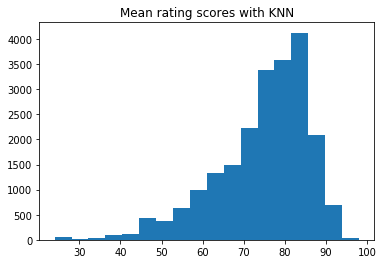

In [62]:
plt.hist(food_inspection_rest["mean_rating_knn"], bins=18)
plt.title('Mean rating scores with KNN')
plt.show()

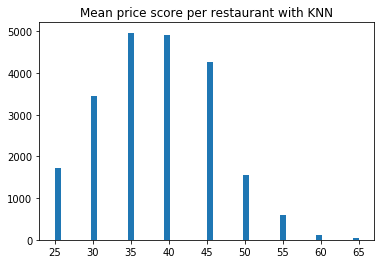

In [63]:
plt.hist(food_inspection_rest["mean_price_knn"],bins=50)
plt.title('Mean price score per restaurant with KNN')
plt.show()

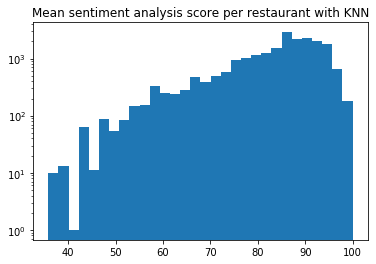

In [64]:
plt.hist(food_inspection_rest["mean_sentiment_knn"],bins=30)
plt.title('Mean sentiment analysis score per restaurant with KNN')
plt.yscale("log")
plt.show()

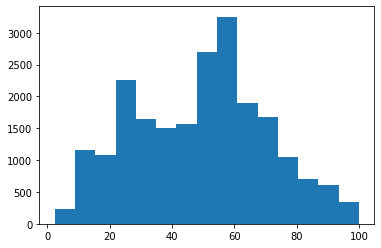

In [65]:
plt.hist(food_inspection_rest["mean_crimes_knn"], bins = 15)
plt.show()

## Synthesis:  overall score bringing together all the assets.
 
In this last part we come up with a final score for each restaurant taking into account the computes score w.r.t reviews, crimes and inspections. 

In [297]:
cr_df = pd.read_pickle('rest_scores_100.p')

In [299]:
cr_df.head()

,name,location,zip,mean_rating_knn,mean_price_knn,mean_sentiment_knn,mean_crimes_knn
1,TACOS & SALSAS 2300 S THROOP ST,"[41.85045102427, -87.65879785567869]",60608.0,74.0,35.0,79.2,59.484222
3,DUNKIN DONUTS 4453 S ARCHER AVE,"[41.81230749019629, -87.7069186298686]",60632.0,62.0,30.0,78.2,52.836485
4,SHEEBA MEAT & GROCERY 4307 W LAWRENCE AVE,"[41.96804517534159, -87.7357496871877]",60630.0,80.0,45.0,86.0,28.021193
5,A & J KRAZY KITCHEN 7547 W IRVING PARK RD,"[41.95243739681394, -87.81649552747085]",60634.0,70.0,30.0,70.0,24.184767
7,Ban Po Chung 3450 W FOSTER AVE,"[41.97577826268285, -87.715618214214]",60625.0,84.0,35.0,90.0,36.924068


In [468]:
restaurant_oriented=restaurant_oriented.merge(cr_df.drop(columns=['location','zip']), on='name')

In [478]:
description = restaurant_oriented['mean_sentiment_knn'].describe()
description

count    21661.000000
mean        83.203305
std         10.520690
min         35.800000
25%         78.000000
50%         86.200000
75%         90.800000
max        100.000000
Name: mean_sentiment_knn, dtype: float64

So we basically add upp all the scores, we weigh them by importance. Note that this can be subjective, we considered for example that the price is not too important, compared to the inpsection scores and the crime scores. An idea for a hypothetical use in an app for example, would be to let the user choose the weights per score so that he could see were the best areas are based on his personal criterias.

In [578]:
restaurant_oriented['first_score']=(1.2*restaurant_oriented['overall_score'] + restaurant_oriented["mean_rating_knn"] + 0.5*(100 - restaurant_oriented["mean_price_knn"]) + 0.7*restaurant_oriented["mean_sentiment_knn"] + 1.2*(100 - restaurant_oriented["mean_crimes_knn"]))/5


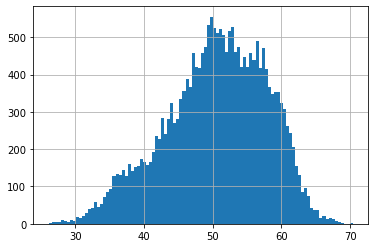

In [579]:
restaurant_oriented['first_score'].hist(bins=100)

In [580]:
d = restaurant_oriented['first_score'].describe()
restaurant_oriented['first_score'] = 100 * (restaurant_oriented['first_score'] - d['min']) / (d['max'] - d['min'])

In [581]:
zip_oriented = zip_oriented.drop(columns = {'first_score'})

In [582]:
zip_oriented = zip_oriented.join(restaurant_oriented.groupby('zip').agg({'first_score':'mean'}))

In [583]:
scoreByZip = zip_oriented.reset_index().astype({'zip':int}).astype({'zip':str})
m = folium.Map(location=[41.8781, -87.6298])

folium.Choropleth(
    geo_data=zip_areas,
    name='choropleth',
    data=scoreByZip,
    columns=['zip', 'first_score'],
    key_on='feature.properties.zip',
    fill_color='RdYlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Score per zip'
).add_to(m)

folium.LayerControl().add_to(m)

In [584]:
m

In [586]:
#m.save('maps/score_per_zip.html')

You can find the map [here](maps/score_per_zip.html).

This map displays the overall score. The dark-green areas in the north need to nuanced, because for those areas we had less data points w.r.t the other zip araes so the score is biased by this missing data. With more data we could imagine that they would come in a more lighter shade of green, so we still consider them as recomendable areas to go out. The worst areas are in the south and eastern parts, which corresponds to districts with fairly high criminality and intermediate to bad inspections scores.

In [585]:
restaurant_oriented.sort_values(['first_score'], ascending=[False]).head(10)

,name,latitude,longitude,zip,facility type,raw_performance,mm_performance,stars,violation_score,norm_violation_score,overall_score,mean_rating_knn,mean_price_knn,mean_sentiment_knn,mean_crimes_knn,first_score,norm_sentiment_knn,final_score
1381,PAMPANGA'S CUISINE FILIPINO RESTAURANT 6407 N ...,41.997533,-87.766901,60646.0,restaurant,19.0,0.468750,5,4.632729,1.464782,32.001353,94.0,35.0,100.0,2.412037,100.000000,1.596539,193.413390
1219,WOLFGANG PUCK (T1 B7) 11601 W TOUHY AVE,42.008536,-87.914428,60666.0,restaurant,42.0,0.708333,5,3.526315,1.382053,51.252261,82.0,25.0,87.0,15.356244,96.146807,0.360879,210.608505
11525,Subway 6352 N Milwaukee AVE,41.996447,-87.787207,60646.0,restaurant,19.0,0.468750,5,3.236005,1.356008,34.568390,90.0,35.0,94.0,6.047070,95.717934,1.026234,189.615460
5445,DUNKIN DONUTS 7156 N HARLEM AVE,42.011607,-87.806787,60631.0,restaurant,19.0,0.468750,5,3.448367,1.375277,34.084054,90.0,35.0,93.4,5.987354,95.298134,0.969204,188.471408
1884,MANCHU WOK (T3 ROTUNDA) 11601 W TOUHY AVE,42.008536,-87.914428,60666.0,restaurant,40.0,0.687500,5,3.548848,1.383984,49.675434,82.0,25.0,87.0,15.356244,95.292258,0.360879,209.031677
416,SMAKTAK 5961 N ELSTON AVE,41.989723,-87.777173,60646.0,restaurant,23.0,0.510417,5,5.761370,1.530879,33.341420,90.0,35.0,94.0,6.047070,95.052987,1.026234,188.388490
11475,Pasta D'Arte 6311 N MILWAUKEE AVE,41.995494,-87.785939,60646.0,restaurant,21.0,0.489583,5,4.886604,1.480956,33.058610,90.0,35.0,94.0,6.047070,94.899720,1.026234,188.105679
673,SUPERDAWG DRIVE-IN 6363 N MILWAUKEE AVE,41.996609,-87.786999,60646.0,restaurant,19.0,0.468750,5,3.988451,1.419386,33.024835,90.0,35.0,94.0,6.047070,94.881416,1.026234,188.071905
1116,THE GREAT AMERICAN BAGEL (T3-H10) 11601 W TOUH...,42.008536,-87.914428,60666.0,restaurant,39.0,0.677083,5,3.611325,1.389274,48.736472,82.0,25.0,87.0,15.356244,94.783395,0.360879,208.092716
4530,EUROPEAN CLASSIC 5930 N ELSTON AVE,41.989107,-87.776496,60646.0,bakery,22.0,0.500000,5,5.626835,1.523716,32.814523,90.0,35.0,94.0,6.047070,94.767439,1.026234,187.861593


Our "TOP 10" restaurants